#Download e instalação dos recursos necessarios

In [ ]:
#clone YOLOv5  
!git clone https://github.com/ultralytics/yolov5  # clonando repositorio
%cd yolov5
%pip install -qr requirements.txt # install dependencies
%pip install -q roboflow

import torch
import os
from IPython.display import Image, clear_output  # to display images

print(f"Setup complete. Using torch {torch.__version__} ({torch.cuda.get_device_properties(0).name if torch.cuda.is_available() else 'CPU'})")

Cloning into 'yolov5'...
remote: Enumerating objects: 11741, done.
remote: Counting objects: 100% (109/109), done.
remote: Compressing objects: 100% (81/81), done.
remote: Total 11741 (delta 41), reused 76 (delta 28), pack-reused 11632
Receiving objects: 100% (11741/11741), 12.47 MiB | 18.29 MiB/s, done.
Resolving deltas: 100% (8034/8034), done.
/content/yolov5
     |████████████████████████████████| 596 kB 33.8 MB/s 
     |████████████████████████████████| 1.6 MB 60.2 MB/s 
     |████████████████████████████████| 145 kB 30.8 MB/s 
     |████████████████████████████████| 178 kB 56.8 MB/s 
     |████████████████████████████████| 1.1 MB 56.5 MB/s 
     |████████████████████████████████| 67 kB 7.8 MB/s 
     |████████████████████████████████| 54 kB 3.3 MB/s 
     |████████████████████████████████| 138 kB 74.8 MB/s 
     |████████████████████████████████| 62 kB 1.6 MB/s 
Setup complete. Using torch 1.12.1+cu113 (Tesla T4)


#Montando o Dataset

* Criação do dataset com 3 classes
* Importação, anotação e treinamento no Roboflow
* Conversão dos dados treinados para o formato YOLOV5


In [ ]:
!pip install joblib

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="P8Esqfp0YvmAst6R42rx")
project = rf.workspace("moto-gj5fy").project("moto-nik1g")
dataset = project.version(2).download("yolov5")

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Moto-2 in yolov5pytorch:: 100%|██████████| 370/370 [00:00<00:00, 1785.71it/s]


# Visualização dos dados

In [ ]:
# Tensorboard 
%load_ext tensorboard
%tensorboard --logdir runs/train

<IPython.core.display.Javascript object>

In [ ]:
# Weights & Biases  (optional)
%pip install -q wandb
import wandb

     |████████████████████████████████| 1.8 MB 36.8 MB/s 
     |████████████████████████████████| 157 kB 62.5 MB/s 
     |████████████████████████████████| 181 kB 75.5 MB/s 
     |████████████████████████████████| 63 kB 1.9 MB/s 
     |████████████████████████████████| 139 kB 76.1 MB/s 
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
roboflow 0.2.14 requires urllib3==1.26.6, but you have urllib3 1.26.11 which is incompatible.


In [ ]:
import sys

def wandb_colab_login():
  """Temporary hack to prevent colab from hanging"""
  sys.modules["google.colab2"] = sys.modules["google.colab"]
  del sys.modules["google.colab"]
  wandb.login()
  sys.modules["google.colab"] = sys.modules["google.colab2"]
wandb_colab_login()

ERROR:wandb.jupyter:Failed to detect the name of this notebook, you can set it manually with the WANDB_NOTEBOOK_NAME environment variable to enable code saving.


<IPython.core.display.Javascript object>

wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [ ]:
from google.colab import drive

drive.mount('/content/gdrive/')

Mounted at /content/gdrive/


In [ ]:
!python train.py --img 640 --batch 64 --epochs 4000 --data {dataset.location}/data.yaml --weights yolov5s.pt --cache

wandb: Currently logged in as: murilomsf (cesarshool). Use `wandb login --relogin` to force relogin
train: weights=yolov5s.pt, cfg=, data=/content/yolov5/Moto-2/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=4000, batch_size=64, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-8-g6728dad Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.

# Avaliando o desempenho do detector YOLOv5 personalizado


In [ ]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

#Executar inferência com pesos treinados

In [ ]:
!python detect.py --weights runs/train/exp/weights/best.pt --img 416 --conf 0.1 --source {dataset.location}/test/images

detect: weights=['runs/train/exp/weights/best.pt'], source=/content/yolov5/Moto-2/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.1, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.2-8-g6728dad Python-3.7.13 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 213 layers, 7018216 parameters, 0 gradients, 15.8 GFLOPs
image 1/21 /content/yolov5/Moto-2/test/images/--btwin-120-preta---26-l---1m75-1m851_jpg.rf.d3c5d565ecd2ee51b51f1ddad6f5b133.jpg: 416x416 1 Bicicleta, Done. (0.008s)
image 2/21 /content/yolov5/Moto-2/test/images/1272063176_jpg.rf.5d29b36d3c747cf8a7c9429dfb317ecf.jpg: 416x416 1 Bicicleta, Done. (0.008s)
image 3/21 /content/yolov5/Moto-2/test/images

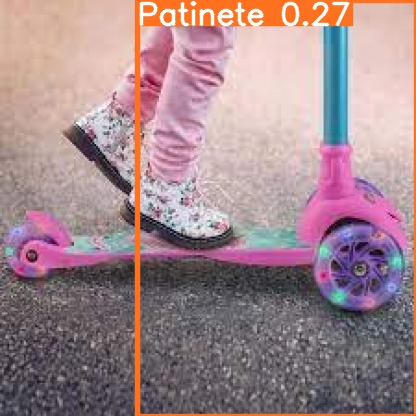

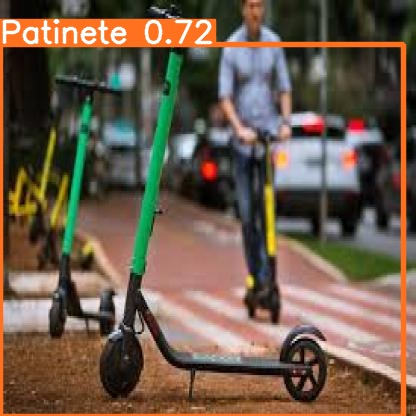

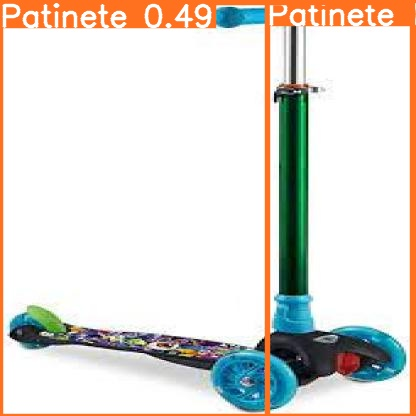

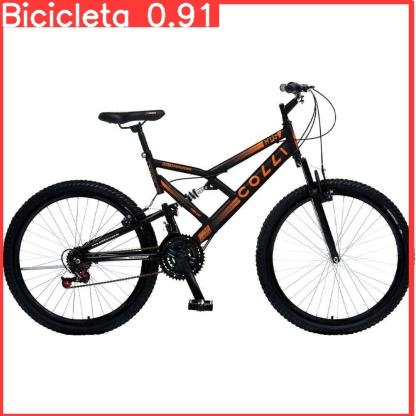

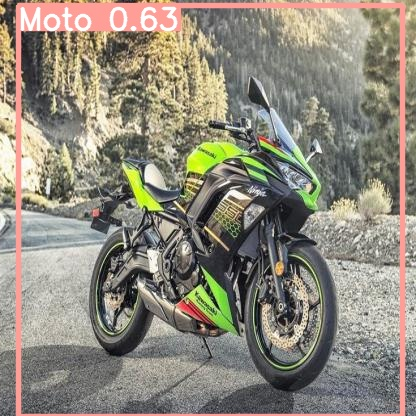

...

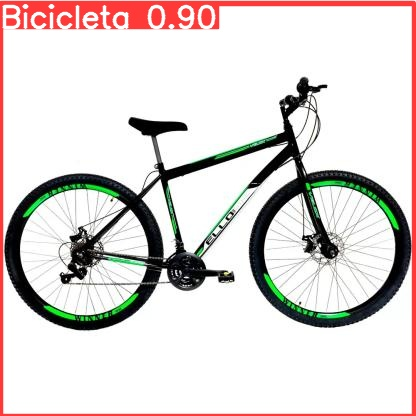

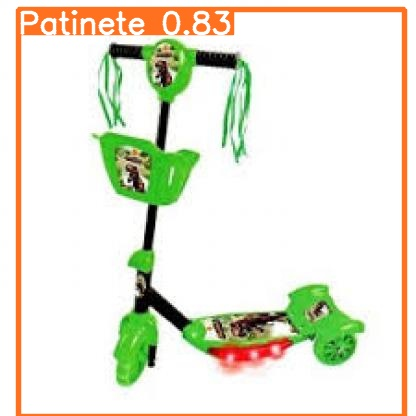

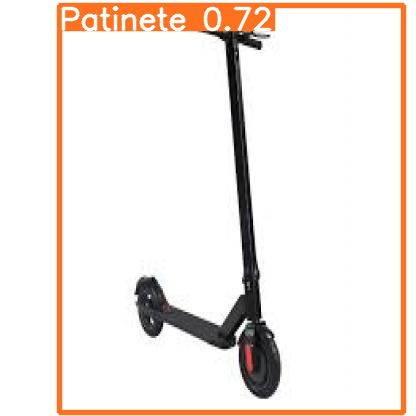

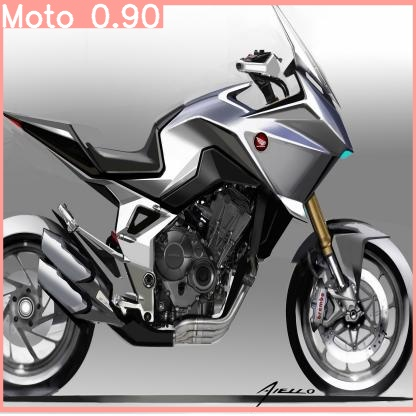

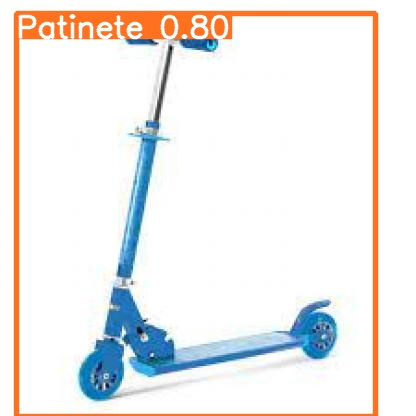

In [ ]:
# Mostrando as inferencias em todas as imagens testadas


import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

#Exportação dos dados

In [ ]:
#Exportação para utilização externa dos dados
from google.colab import files
files.download('./runs/train/exp/weights/best.pt')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>